Many who follow politics have noticed that the tweets from [@RealDonaldTrump](https://twitter.com/realDonaldTrump) don't seem to be written by just one person. Some of them&mdash;often written early in the morning&mdash;use language that is unique to Donald Trump: insults to political opponents, attacks on the media, etc. Others&mdash;usually sent during normal working hours&mdash;include language that any President would use: stating policy positions, endorsing other Republicans, etc.

This notebook is my attempt to distinguish between Tweets worded in a Trumpy way and those worded Presidentially. I suspect the Trumpy tweets were actually written by Donald Trump, while the Presidential ones are usually written by White House staffers, though I have no inside knowledge on the matter. This leads to the following question: will tweets from [@RealDonaldTrump](https://twitter.com/realDonaldTrump)&mdash;based only on diction&mdash;cluster into two groups?

# Imports and loading the data

We start by importing pandas and Altair. We're using Altair for visualization because it will allow us to easily make the complicated plots near the end of this notebook.

In [1]:
import pandas as pd
import altair as alt
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

The tweets from [@RealDonaldTrump](https://twitter.com/realDonaldTrump) between inauguration day 2017 and November 28, 2018 are stored in `TrumpTweets.json`, which I created using the [Trump Twitter Archive](http://trumptwitterarchive.com/archive). We'll only use the text of the tweets for the analysis, but we will also use temporal data to verify that Trumpy tweets are sent early in the morning. The time data from Twitter's api is from the GMT timezone; we convert it to the Eastern time zone, where Trump is most of the time.

In [2]:
trump_tweets = pd.DataFrame(pd.read_json('TrumpTweets.json', encoding='utf-8')[['text', 'created_at']])

trump_tweets['created_at'] = pd.to_datetime(trump_tweets.created_at)

trump_tweets['created_at'] = trump_tweets.created_at.dt.tz_localize('GMT')

trump_tweets['created_at'] = trump_tweets.created_at.dt.tz_convert('US/Eastern')

In [3]:
trump_tweets.head(10)

,text,created_at
0,Congratulations to Senator Cindy Hyde-Smith on...,2018-11-27 22:42:08-05:00
1,"Brenda Snipes, in charge of voting in Broward ...",2018-11-27 22:38:48-05:00
2,The Mueller Witch Hunt is a total disgrace. Th...,2018-11-27 19:31:37-05:00
3,Very disappointed with General Motors and thei...,2018-11-27 14:05:39-05:00
4,....for electric cars. General Motors made a b...,2018-11-27 14:05:39-05:00
5,Polls are open in Mississippi. We need Cindy H...,2018-11-27 08:32:57-05:00
6,....terrible Gang of Angry Democrats. Look at ...,2018-11-27 08:07:23-05:00
7,....The Fake News Media builds Bob Mueller up ...,2018-11-27 07:42:58-05:00
8,"The Phony Witch Hunt continues, but Mueller an...",2018-11-27 07:30:37-05:00
9,"RT @GOP: “Tomorrow, the voters of this state w...",2018-11-26 23:54:58-05:00


# Preprocessing

Before we do any analysis with the tweets, it's important to preprocess them. I've written my own module, `preprocessing.py`, to take care of this for me. This module includes the function `preprocess_text`, which takes a string as input and:
 - removes urls
 - removes punctuation
 - removes capitalization
 - stems the words, which removes suffixes (e.g. 'preprocessing' becomes 'preprocess')

In [4]:
from preprocessing import preprocess_text

In [5]:
trump_tweets['text'] = trump_tweets.text.apply(preprocess_text)

Now that we've preprocessed all of the tweets, we are no longer interested in those that only contained urls (which are now blank). We are also not interested in retweets because we want to analyse tweets that actually came from the @RealDonaldTrump account. The below line removes both cases from the `trump_tweets` DataFrame.

In [7]:
trump_tweets = trump_tweets.loc[(trump_tweets.text != '') & (trump_tweets.text.str[:3] != 'rt ')]

In [8]:
trump_tweets.head()

,text,created_at
0,congratul to senat cindi hyde smith on your bi...,2018-11-27 22:42:08-05:00
1,brenda snipe in charg of vote in broward count...,2018-11-27 22:38:48-05:00
2,the mueller witch hunt is a total disgrac they...,2018-11-27 19:31:37-05:00
3,veri disappoint with gener motor and their ceo...,2018-11-27 14:05:39-05:00
4,for electr car gener motor made a big china be...,2018-11-27 14:05:39-05:00


In [6]:
trump_tweets.shape

(5638, 2)

We are now left with tweets that came from Donald Trump's Twitter account, and they have been stemmed and stripped of capitalization, punctuation, and urls. Let's see if we can find differences in the diction of tweets that cry "Witch Hunt!" and those that are more presidential.

# Unigrams

In the language of Natural Language Processing (NLP), single words are called _unigrams_. More generally, there are _bigrams_, which are occurances of pairs of words, and _ngrams_, which are occurances of n consecutive words. In this section, we'll only use the unigrams in tweets from @RealDonaldTrump to do the analysis.

## Tf-idf

One of the most common ways to quantify text data is to simply count the occurrances of each word in each tweet; this is called a _bag of words_ model. A weakness of these models is that the most commonly-used words tend to dominate the scores, while lesser-used words are usually more informative. A solution to this is instead using term frequency-inverse document frequency, where the score for each word is weighted to account for the prevalence of the word in the entire corpus of documents (in our case, the collection of all @RealDonaldTrump tweets since Inauguration Day).

In scikit-learn, we obtain a tf-idf matrix whose rows represent tweets, and whose columns represent words. Each component of the matrix is the tf-idf score for that word in that tweet. For more details on scikit-learn's implementation of tf-idf, go [here](http://scikit-learn.org/stable/modules/feature_extraction.html#tfidf-term-weighting).

One more thing: very common words like "and" and "the" tend to dominate these scores, even when using idf weighting. We therefore don't consider them, and they do not get a column in the tf-idf matrix. These ignored words are called stop words, and scikit-learn has its own collection of them. To these, we add the words from Trump's campaign slogan, "make America great again", and its related hashtag, "maga", because they occur frequently in his tweets and do not give much information--the associated topics and tone of tweets including this phrase are quite varied. We also add "wa", "thi", and "ha", which are stemmed versions of usual stop words. Finally, with the `min_df` argument in scikit-learn's `TfidfVectorizer`, we specify that we only want a word to be counted if it appears at least four times in all @RealDonaldTrump tweets. This is because, in the Trump Twitter Archive, some deleted tweets appear, and thus there are sets of almost-identically-worded tweets. Since the wordings involved are sometimes unique, these pairs of tweets appear as outliers unless we specify `min_df = 4`.

In [9]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
my_stop_words = ENGLISH_STOP_WORDS.union(['make', 'america', 'great', 'again', 'maga', 'wa', 'thi', 'ha'])
tf_idf_vectorizer = TfidfVectorizer(stop_words= my_stop_words, min_df = 4)
tf_idf = tf_idf_vectorizer.fit_transform(trump_tweets.text)

It turns out that this section works better if we scale the columns of the tf-idf matrix; that is, if we subtract from each tf-idf score the mean of each column and then divide by each column's standard deviation. This will help the K-Means algorithm that we use below to not hone in on outliers in the data.

In [10]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_tf_idf = scaler.fit_transform(tf_idf.toarray())

## LSA

LSA, or Latent Semantic Analysis, is a fancy term for performing a singular value decomposition on the tf-idf matrix. Here, we will use LSA to visualize our data and get a sense for the differences between tweets. I also add the first two columns of the transformed tf-idf matrix&mdash;which is made up of the projections of the original matrix onto the first two right singular vectors&mdash;to our `trump_tweets` dataframe.

In [11]:
from sklearn.decomposition import TruncatedSVD
svdecomposer = TruncatedSVD(n_components = 50)
svd = svdecomposer.fit_transform(scaled_tf_idf)

In [12]:
trump_tweets['LSA1'] = svd[:,0]
trump_tweets['LSA2'] = svd[:,1]

Let's see what the data looks like when we plot the first two components from LSA:

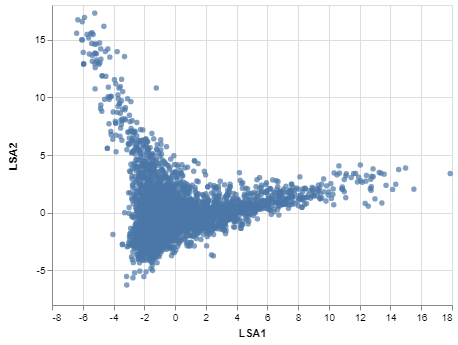

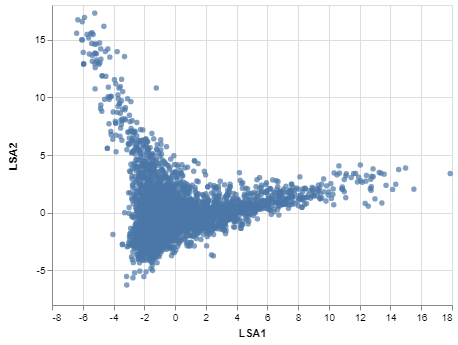

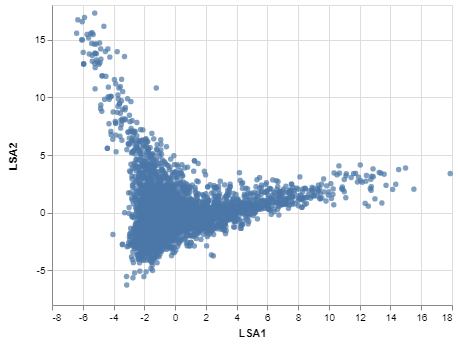

In [13]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA1',
    y = 'LSA2'
)

It looks like a lot of tweets lie near the first these axes, and those that don't tend to have negative `LSA1` scores. But what do these axes mean? We've plotted the projection of each tweet onto the first two right singular vectors. Each of these vectors have components corresponding to words that appear in tweets from @RealDonaldTrump. We can use the values of these components to see what kind of tweets score high and low along these axes. The function defined below returns a DataFrame that shows, for each right singular vector, the component value corresponding to each word.

In [14]:
def get_term_weight_LSA(vectorizer, SVD):
    """Given already-fitted tfidf vectorizer and SVD object, returns a pandas DataFrame with the terms as its indices and
    weights corresponding to the right singular vectors as columns."""
    import pandas as pd
    
    feature_names = vectorizer.get_feature_names()
    components = SVD.components_
    df_columns_dict = {'LSA' + str(component_number + 1): 
                       components[component_number] for component_number in range(len(components))}
    term_weight_df = pd.DataFrame(data=df_columns_dict, index=feature_names)
    
    return term_weight_df.sort_values('LSA1', ascending=False)

In [15]:
LSA_term_weights = get_term_weight_LSA(tf_idf_vectorizer, svdecomposer)

In [16]:
LSA_term_weights.LSA1.head(20)

fbi        0.165041
hillari    0.154035
witch      0.145644
hunt       0.145508
clinton    0.142904
crook      0.125234
strzok     0.120915
rig        0.119600
page       0.113963
collus     0.110751
lover      0.106588
dossier    0.105389
mueller    0.104444
email      0.102488
comey      0.101750
russia     0.096642
whi        0.096112
dnc        0.095979
russian    0.095542
lisa       0.095539
Name: LSA1, dtype: float64

In [17]:
LSA_term_weights.LSA1.tail(20)

job           -0.035270
nation        -0.035495
thank         -0.037866
state         -0.038551
cut           -0.043467
congressman   -0.043736
governor      -0.046410
vote          -0.048057
crime         -0.048288
honor         -0.049422
today         -0.049544
tax           -0.049858
love          -0.051099
2nd           -0.065659
border        -0.068162
amend         -0.069598
strong        -0.072778
militari      -0.073212
endors        -0.077185
vet           -0.080339
Name: LSA1, dtype: float64

The first right singular vector has large positive components corresponding to words that we associate with Trump specifically; in particular, these words mention political rivals, like the DNC and Hillary Clinton, as well as investigations by the FBI and special counsel.

Meanwhile, this same vector has negative components corresponding to words that we might normally expect from a President: "honor," "military," and policy issues like "border," "trade," and "taxes."

In other words, the "LSA1" axis discriminates between tweets that are Trumpy and those that are Presidential. It is remarkable that we are able to do this using something as simple as a singular value decomposition.

What about the second right singular vector? What is the difference between tweets with a positive "LSA2" score and a negative "LSA2" score?

In [18]:
LSA_term_weights['LSA2'].sort_values(ascending=False).head(20)

endors         0.225252
amend          0.220097
vet            0.219794
crime          0.218139
2nd            0.198735
border         0.182478
strong         0.177654
militari       0.143124
congressman    0.139767
total          0.124045
vote           0.111535
second         0.108630
pelosi         0.108177
troy           0.102450
nanci          0.097734
oppon          0.093589
puppet         0.093358
tough          0.091043
need           0.090967
governor       0.090193
Name: LSA2, dtype: float64

In [19]:
LSA_term_weights['LSA2'].sort_values(ascending=False).tail(20)

tariff      -0.036155
flotu       -0.038145
melania     -0.040123
unit        -0.040223
jong        -0.040838
nation      -0.041560
kim         -0.045514
today       -0.047102
xi          -0.047757
whitehous   -0.049100
china       -0.053255
welcom      -0.054721
prime       -0.056543
meet        -0.057325
minist      -0.057337
trade       -0.058003
presid      -0.058947
north       -0.062747
honor       -0.065820
korea       -0.070500
Name: LSA2, dtype: float64

Tweets with a positive "LSA2" score tend to be about domestic policy ("crime," "2nd amendment," "border"), while those with a negative "LSA2" score tend to be about foreign policy, often mentioning foreign leaders like Xi Jinping, Shinzo Abe, and Kim Jong Un.

## K-Means

Now it's time to see if Trump's tweets belong to two different clusters: Trumpy and Presidential. If so, we expect that these two clusters will correspond to the left and right halves of the plot above.

We will use K-means clustering, which takes a specified number (K) of clusters. The idea here is to randomly place K cluster _centroids_, assign points to clusters according to which cluster centroid they are closest to, and then move the centroids to the mean position of the points in its cluster. These last two steps are repeated until the centroids no longer move. For more information on scikit-learn's implementation of this algorithm, see its [documentation](http://scikit-learn.org/stable/modules/clustering.html#k-means).

The following code was used to create the K-means model:

```python
from sklearn.cluster import KMeans
kmeans_unigrams = KMeans(n_clusters=2, n_init = 100)
kmeans_unigrams.fit(scaled_tf_idf)
```

The K-means algorithm often converges to a local minimum and therefore assigns clusters sub-optimally. To mitigate this, K-means is usually run more than once. I've specified `n_int = 100`, meaning that the algorithm is repeated 100 times, when I defined the `KMeans` object. I've also `pickle`d the model I used, and we'll load it here.

In [20]:
from pickle import load
kmeans_unigrams = load(open('kmeans_unigrams.pickle', 'rb'))

The actual label that K-means gives a cluster is random, meaning that even if K-means gave the same clusters every time, their labels would be different each time you ran the algorithm. My solution for this is to order the cluster labels by cluster size, so that the label `0` corresponds to the largest cluster, `1` to the next largest, etc. The function defined below takes a scikit-learn object as input and returns the same object, but with the labels and their associated centroids ordered according to cluster size.

```python
def reorder_cluster_labels_and_centroids(KMeans):
    """Given a scikit-learn KMeans object, returns the same KMeans object but with the labels_ ordered according to
    cluster size and the cluster_centers_ also reordered accordingly."""
    import numpy as np
    
    # Get the labels and their associated cluster sizes.
    unique_labels, old_label_counts = np.unique(KMeans.labels_, return_counts=True)
    
    # Sort the labels in descending order according to cluster size.
    sorted_unique_labels = np.flipud(np.argsort(old_label_counts))
    
    # Make a dictionary assigning old cluster labels to the new, sorted ones.
    label_dict = {sorted_unique_labels[new_label]: new_label for new_label in range(len(unique_labels))}
    
    # Replace the labels with the sorted ones.
    KMeans.labels_ = np.vectorize(label_dict.get)(KMeans.labels_)
    
    # Reorder the cluster_centers_.
    KMeans.cluster_centers_ = KMeans.cluster_centers_[sorted_unique_labels]
    
    return KMeans
```

I then ran this function on the KMeans object before pickling it:

```python
kmeans = reorder_cluster_labels_and_centroids(kmeans)
```

In [21]:
trump_tweets['unigrams_cluster'] = kmeans_unigrams.labels_

Let's see how these cluster labels correspond to Trumpiness.

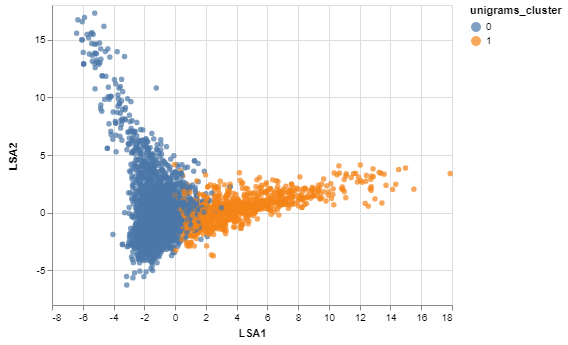

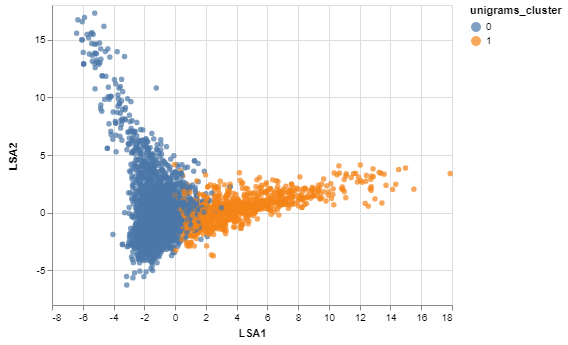

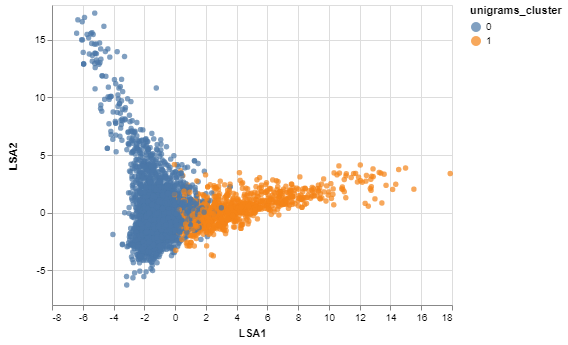

In [22]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA1',
    y = 'LSA2',
    color = 'unigrams_cluster:N'
)

Just like we hoped, it seems that the tweets from @RealDonaldTrump do cluster into two groups, and these two groups correspond to the Trumpiness of the language used. Let's modify the term_weight function above to work on the centroids of K-means clusters:

In [23]:
def get_term_weight_KMeans(vectorizer, KMeans):
    """Given an already-fitted tfidf vectorizer and a KMeans object, returns a pandas DataFrame with the terms as its indices and
    weights corresponding to the cluster centroids as columns."""
    import pandas as pd
    
    feature_names = vectorizer.get_feature_names()
    centroids = KMeans.cluster_centers_
    df_columns_dict = {'cluster' + str(cluster_number): 
                       centroids[cluster_number] for cluster_number in range(len(centroids))}
    term_weight_df = pd.DataFrame(data=df_columns_dict, index=feature_names)
    
    return term_weight_df.sort_values('cluster0', ascending=False)

In [24]:
term_weight_KMeans_unigrams = get_term_weight_KMeans(tf_idf_vectorizer, kmeans_unigrams)

In [25]:
term_weight_KMeans_unigrams.head(20)

,cluster0,cluster1
border,0.052688,-0.202066
thank,0.050781,-0.194755
today,0.049096,-0.188292
honor,0.048972,-0.187815
countri,0.048337,-0.185382
tax,0.047533,-0.182297
vote,0.047418,-0.181855
unit,0.047409,-0.181822
trade,0.044286,-0.169844
militari,0.043286,-0.166011


In [26]:
term_weight_KMeans_unigrams.tail(20)

,cluster0,cluster1
campaign,-0.102124,0.391662
rig,-0.103985,0.398799
whi,-0.106043,0.406692
investig,-0.109454,0.419774
phoni,-0.110985,0.425644
report,-0.112922,0.433073
russia,-0.121203,0.464834
russian,-0.122297,0.469029
crook,-0.124625,0.477959
comey,-0.125016,0.479456


Indeed, the tweets positively associated with cluster 0, the presidential cluster, tend to be either unifying or about specific policy topics, whereas those positively associated with the Trumpy cluster tend to be about Hillary Clinton, investigations into his campain, or negative news coverage. This is clear enough that I'm going to relabel the clusters as "Presidential" and "Trumpy", which will make our last plot a little more clear. While I'm at it, I'll also relabel the axes and change the colors to be more informative.

In [27]:
unigrams_cluster_dict = {0: 'Presidential',
                         1: 'Trumpy'}
trump_tweets['Wording'] = trump_tweets['unigrams_cluster'].map(unigrams_cluster_dict)

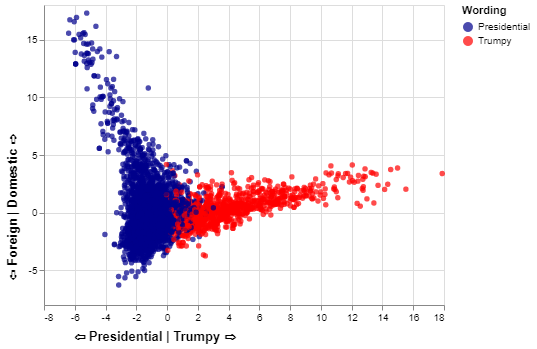

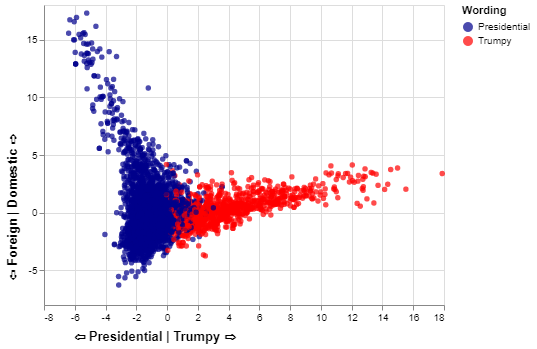

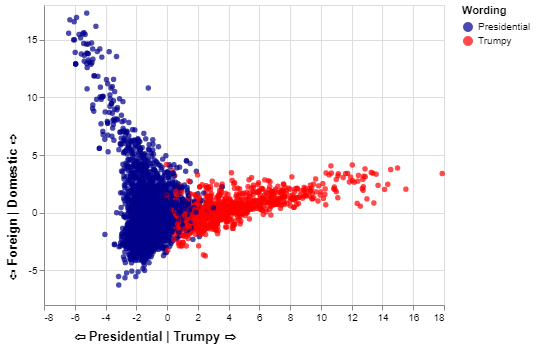

In [28]:
alt.Chart(trump_tweets).configure_axisX(
    titleFontSize = 13, 
    titleX = 110, 
    titleY = 25
).configure_axisY(
    titleFontSize = 13,
    titleY = 202,
    titleX = -25
).mark_circle().encode(
    x = alt.X('LSA1', axis = alt.Axis(title = '\u21e6 Presidential | Trumpy \u21e8')),
    y = alt.Y('LSA2', axis = alt.Axis(title = '\u21e6 Foreign | Domestic \u21e8')),
    color = alt.Color('Wording', scale = alt.Scale(domain = ['Presidential', 'Trumpy'], range=['darkBlue','red']))
)

At the beginning of this notebook, I noted how Trumpy tweets are often sent early in the morning. Let's see if the data agrees. Below is a histogram showing the number of tweets by hour of the day.

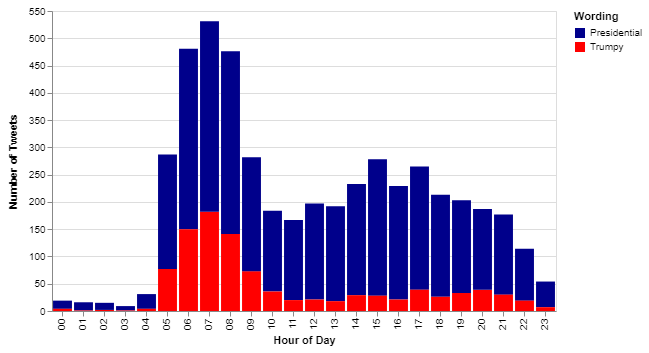

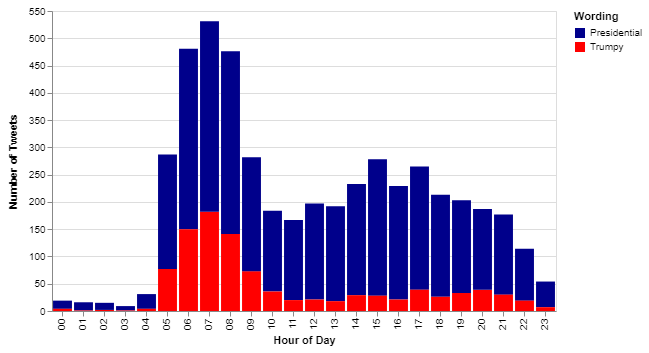

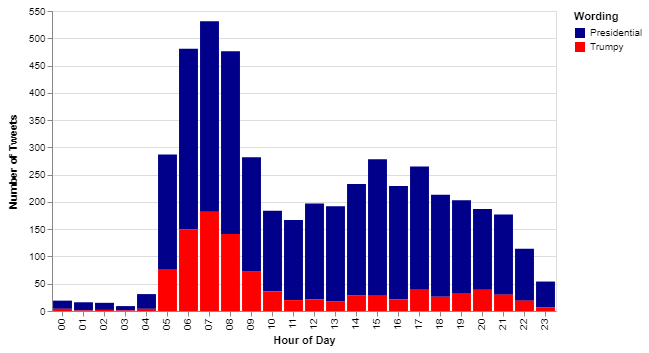

In [29]:
alt.Chart(trump_tweets).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day')),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
    color = alt.Color('Wording', scale = alt.Scale(
        domain = ['Presidential', 'Trumpy'], 
        range=['darkBlue','red']))
)

As expected, the Trumpy tweets are most often sent early in the morning, and the tweets sent during normal working hours are overwhelmingly presidential. Surprisingly, most of the early-morning tweets are in the Presidential cluster. I suspect that most early-morning tweets are, in fact, written by Trump; it is difficult to believe that White House staffers would feel the need to tweet from his account at 6:00 am. However, the wording of the "presidential" early-morning tweets do not make the authorship obvious. I suspect the clustering would work better if we took more than diction into account; the President's grammar has its own quirks, for example. Authorship clustering is an area of active research, and [this paper](https://people.cs.umass.edu/~pat/pdfs/Verga%20Efficient%20Authorship%20Clustering.pdf) by Verga et al. describes creating a similarity matrix by computing the [Imposter Similarity](https://pdfs.semanticscholar.org/5c2b/6876df693e096c6c150a5b0d2a2c05043003.pdf) between pairs of documents, and includes character ngrams as features. I suspect that method would work better than the relatively simple one presented here.

It seems, then, that the tweets in the Trumpy cluster are the ones that were most obviously written by Trump. We cannot interpret the Presidiential cluster as only including tweets written by staffers.

# Bigrams

So far, we've been successful at showing how some tweets from the @RealDonaldTrump are worded significantly differently than others. But there is a lot of overlap between our Trumpy and Presidential clusters. Let's see if we can get them to separate more.

One way to improve NLP algorigthms is to use bigrams. So far, the entries in our tf-idf matrix have been based on occurances of single words. This works to a degree, but it ignores the context in which the words are used, and so we lose some of the information in each tweet. One of the ways to include contextual information is to also look at pairs of consecutive words, called _bigrams_ in the NLP literature. We can use bigrams by setting the `ngrams_range` in scikit-learn's `TfidfVectorizer`.

In [30]:
bigrams_vectorizer = TfidfVectorizer(ngram_range = (1,2), stop_words= my_stop_words, min_df = 4)
bigrams = bigrams_vectorizer.fit_transform(trump_tweets.text)

## Visualization

Let's try to visualize what's going on here. We'll start with LSA again:

In [31]:
svd_bigrams = svdecomposer.fit_transform(bigrams)

In [32]:
trump_tweets['LSA1_bigrams'] = svd_bigrams[:,0]
trump_tweets['LSA2_bigrams'] = svd_bigrams[:,1]
trump_tweets['LSA3_bigrams'] = svd_bigrams[:,2]
trump_tweets['LSA4_bigrams'] = svd_bigrams[:,3]

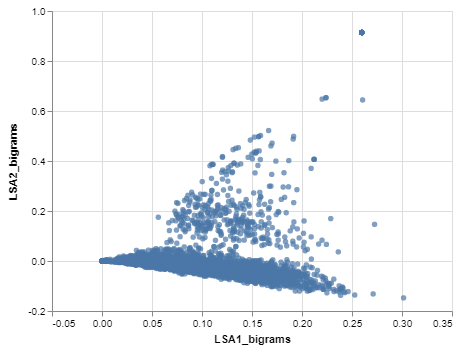

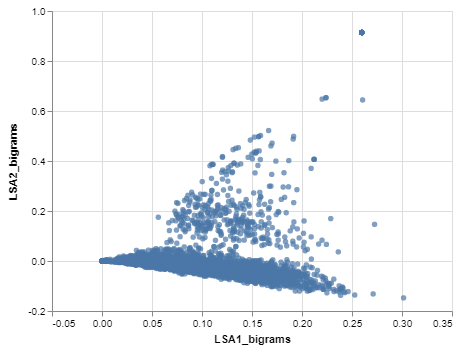

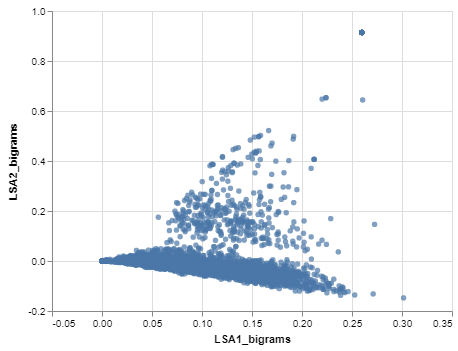

In [33]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA1_bigrams',
    y = 'LSA2_bigrams'
)

the chart above looks very different from what we had with the unigrams. One can maybe identify one cluster that is distinct from the mass near the LSA1_bigrams axis. Let's look at the next two dimensions we get from LSA:

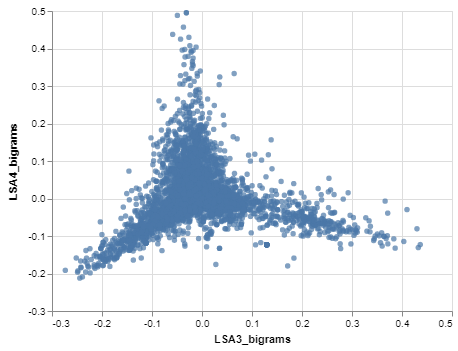

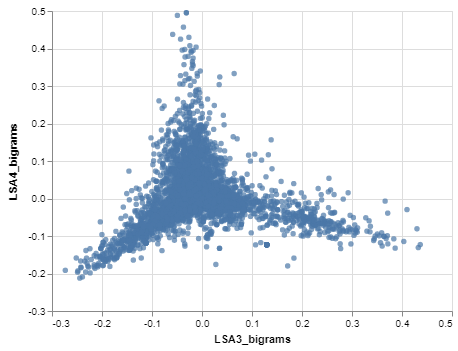

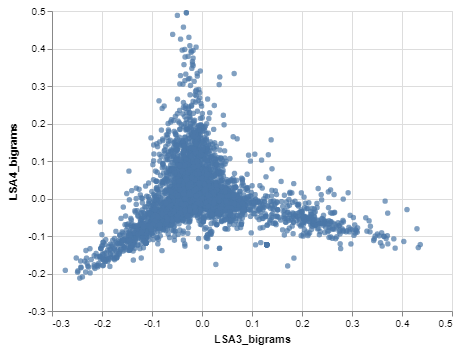

In [34]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA3_bigrams',
    y = 'LSA4_bigrams'
)

Here, we can see three clusters of tweets: those with a high LSA3_bigrams score, those with a high LSA4_bigrams score, and those with negative LSA3_bigrams and LSA4_bigrams scores. There seems to be a lot more going on here than there was with the unigrams. 


To get a better sense of this, let's use t-SNE. T-SNE attempts to take points in a high-dimensional space and map them to a 2- or 3-dimensional space. The positions in the low-dimensional space are based on pairwise distances: points close together in the high-dimensional space are usually placed close together in the low-dimensional space. It should therefore be useful in visualizing the clusters we have here. I run t-SNE on the 50-dimensional output of the truncated Singular Value Decomposition because it trains much more quickly that way. For more details on how t-SNE works, see [this introduction from O'Reilly](https://www.oreilly.com/learning/an-illustrated-introduction-to-the-t-sne-algorithm) or [the original paper from van der Maaten and Hinton](http://www.jmlr.org/papers/volume9/vandermaaten08a/vandermaaten08a.pdf). For more details on scikit-learn's implementation, see [their documentation](http://scikit-learn.org/stable/modules/manifold.html#t-distributed-stochastic-neighbor-embedding-t-sne).

In [35]:
from sklearn.manifold import TSNE
tsne = TSNE(learning_rate = 10)
embedding_bigrams = tsne.fit_transform(svd_bigrams)

In [36]:
trump_tweets['embedding1'] = embedding_bigrams[:,0]
trump_tweets['embedding2'] = embedding_bigrams[:,1]

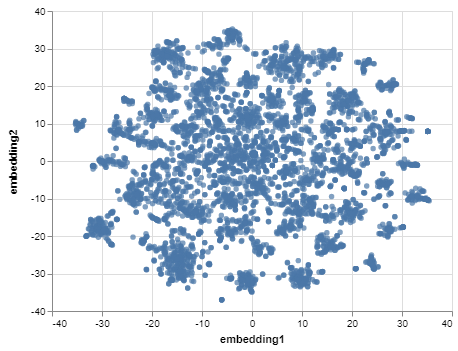

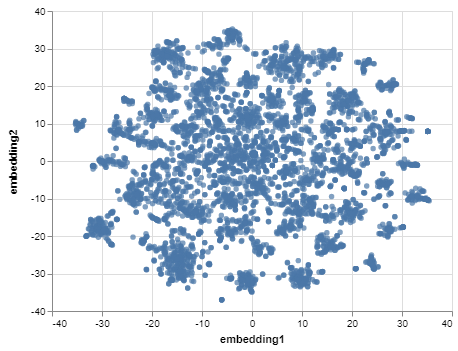

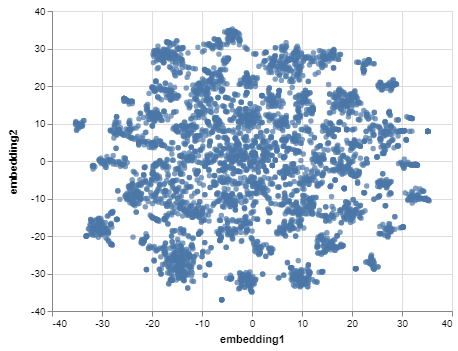

In [37]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'embedding1',
    y = 'embedding2'
)

Note that t-SNE also tends to settle on local optima in its cost function, so if you run this notebook for yourself your plot is likely to look different from the one above. Regardless, we can see that there are definitely more than two clusters here. This will inform our K-means algorithm.

## KMeans

From a lot of trial-and-error, it seems that the optimal number of clusters is ~30 when we're using bigrams. I ran K-means with that knowledge:

```python
kmeans_bigrams = KMeans(n_clusters = 30, n_init=100)
kmeans_bigrams.fit(svd_bigrams)
kmeans_bigrams = reorder_cluster_labels_and_centroids(kmeans_bigrams)
```
Note that I ran K-means on `svd_bigrams`, the output of the truncated Singular Value Decomposition. This way, K-means only has to train on a 50-dimensional subspace of the original data, which goes much more quickly. The reduced training time is especially useful with such a large number of clusters. I expect that this subspace will retain enough of the variance of the original data that K-means will find the clusters just fine (after all, t-SNE was able to). Once again, I `pickle`d the model I settled on. Let's load it:

In [38]:
kmeans_bigrams = load(open('kmeans_bigrams.pickle', 'rb'))

In [39]:
trump_tweets['bigrams_cluster'] = kmeans_bigrams.labels_

The default color scheme in Altair only has 10 colors, so to see all of the clusters clearly we're going to need to change the color scheme, which we do with the `scale` input. Here I'm copying most of the colors from Vega's Category20b and Category20c [color schemes](https://vega.github.io/vega/docs/schemes/#category20).

In [40]:
scale = alt.Scale(domain = list(range(30)),
                  range = ['#3182bd', '#6baed6', '#9ecae1', '#c6dbef',
                           '#e6550d', '#fd8d3c', '#fdae6b', '#fdd0a2', 
                           '#31a354', '#74c476', '#a1d99b', '#c7e9c0', 
                           '#636363', '#969696', '#bdbdbd', '#d9d9d9', 
                           '#393b79', '#5254a3', '#6b6ecf', '#9c9ede', 
                           '#637939', '#8ca252', '#b5cf6b', '#cedb9c', 
                           '#8c6d31', '#bd9e39', '#e7ba52', '#e7cb94', 
                           '#843c39', '#ad494a', '#d6616b', '#e7969c', 
                           '#7b4173', '#a55194', '#ce6dbd', '#de9ed6']
                 )

Let's now look at how the t-SNE embedding plot looks when we color by cluster:

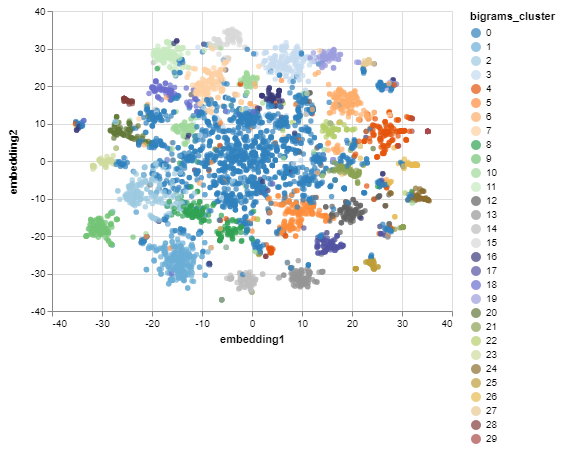

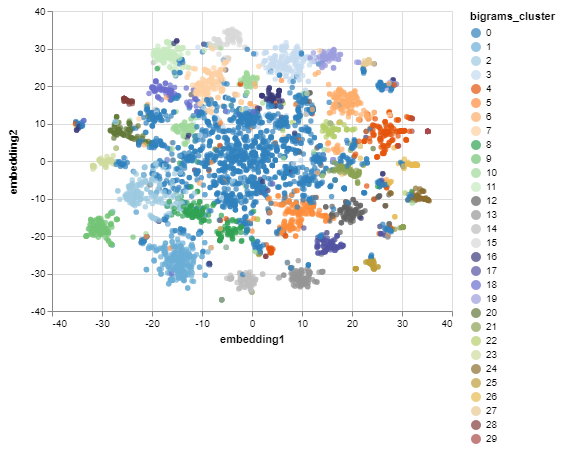

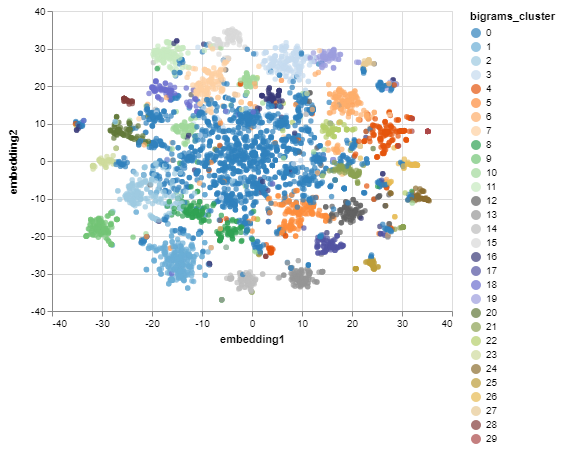

In [41]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'embedding1',
    y = 'embedding2',
    color = alt.Color('bigrams_cluster:N', scale = scale)
)

It looks like the K-means clusters correspond pretty well with the t-SNE embeddings, but the largest cluster has far more tweets than the others, and dominates the chart. Let's chart all tweets other than that cluster.

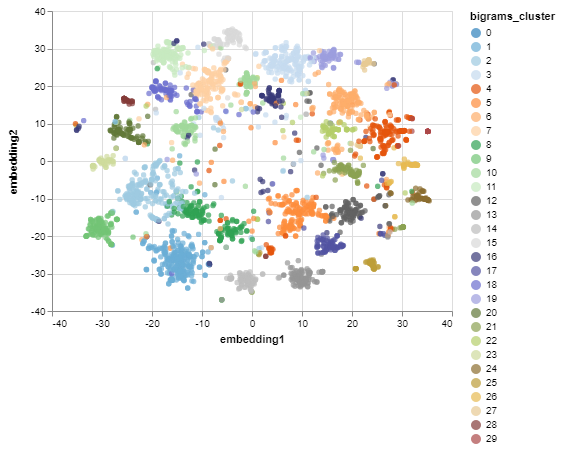

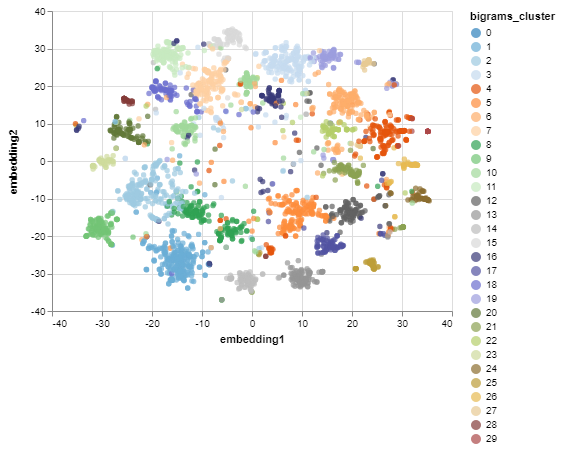

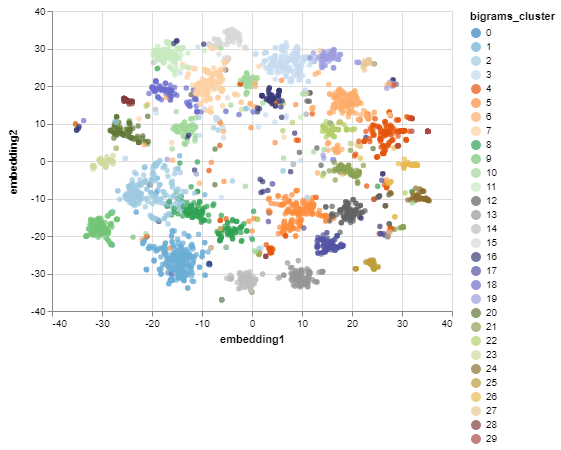

In [42]:
alt.Chart(trump_tweets.loc[trump_tweets.bigrams_cluster != 0]).mark_circle().encode(
    x = 'embedding1',
    y = 'embedding2',
    color = alt.Color('bigrams_cluster:N', scale=scale)
)

Now it is very clear the the clusters we see visually from t-SNE and those that K-means picks up on are nearly the same. This lends credence to the thought that these clusters represent something "real" in the data&mdash;these two independent, unsupervised learning algorithms came to much the same conclusions. But what do these clusters mean? What kind of words are in the tweets of each cluster? When we perform t-SNE, we lose the original high-dimensional data. However, we can use the term-weight function we defined above to figure out what the K-means algorithm picked up on. We just need to modify it to take into account that the components of these centroids are currently expressed with respect to the right singular vectors. This is a different coordinate basis than the original tf-idf matrix is in.

Note that due to the high number of clusters, K-means is especially likely to settle on a local optimum. This means that if you generate a K-means model for yourself, the clusters and their associated topics are likely to be different, though some clusters are consistent across different runs.

In [43]:
def get_term_weight_KMeans_from_LSA(vectorizer, KMeans, svdecomposer):
    """Given an already-fitted tfidf vectorizer, KMeans clusterer, and TruncatedSVD decomposer, returns a pandas DataFrame
    with the terms as its indices and weights corresponding to the cluster centroids as columns."""
    import pandas as pd
    import numpy as np
    
    feature_names = vectorizer.get_feature_names()
    
    # The centroids expressed with respect to the right singular vectors form the SVD.
    centroids_LSA = KMeans.cluster_centers_
    
    # Use the components of the right singular vectors to change to the tf-idf coordinates.
    centroids_tfidf = np.array([np.dot(centroid, svdecomposer.components_) for centroid in centroids_LSA])
    
    df_columns_dict = {'cluster' + str(cluster_number): 
                       centroids_tfidf[cluster_number] for cluster_number in range(len(centroids_tfidf))}
    term_weight_df = pd.DataFrame(data=df_columns_dict, index=feature_names)
    
    return term_weight_df.sort_values('cluster0', ascending=False)

In [44]:
term_weights_bigrams = get_term_weight_KMeans_from_LSA(bigrams_vectorizer, kmeans_bigrams, svdecomposer)

In [45]:
term_weights_bigrams.sort_values('cluster1', ascending=False).cluster1.head(10)

new          0.158698
fake         0.151464
fake new     0.140062
media        0.082918
new media    0.062555
stori        0.041687
cnn          0.039247
report       0.032333
time         0.022199
just         0.021853
Name: cluster1, dtype: float64

The tweets in cluster 1 tend to mention negative media coverage, which President Trump calls "fake news". What about the rest? You can modify the above cell to look at the weights corresponding to other terms. I've done so, and it seems as if the rest of the clusters can be labelled as follows:

| Cluster Label | Topic |
| -------:|:-----:|
| 0 | Miscellaneous |
| 1 | Media Coverage |
| 2 | Hillary Clinton/FBI |
| 3 | Immigration |
| 4 | "Thank You" |
| 5 | Trade |
| 6 | American People |
| 7 | Politics and Congressional Votes |
| 8 | President Trump |
| 9 | Mueller Investigation |
| 10 | Congratulating Election Winners |
| 11 | Taxes |
| 12 | United States |
| 13 | Korea and China | 
| 14 | White House |
| 15 | Endorsements |
| 16 | Working Hard |
| 17 | "I look forward to..." |
| 18 | Healthcare |
| 19 | Law Enforcement |
| 20 | Stock Market |
| 21 | Welcoming People to the White House |
| 22 | "Together" |
| 23 | Supreme Court |
| 24 | "Happy Birthday" |
| 25 | Media Interviews |
| 26 | Rallies |
| 27 | "God Bless the USA" |
| 28 | Jobs |
| 29 | "Thank You" |

Again, if you run K-means for yourself, you are likely to get slightly different clusters.

As implied by the chart above, the clusters we get when including bigrams in our terms correspond to specific topics that @RealDonaldTrump has tweeted about. You might notice that there are two "thank you" clusters. This is because a small subset of these tweets say "thank you" and nothing else other than stop words. Those tweets are therefore all in the exact same location, and they are far enough away from similar tweets that K-means assigns another centroid to it.

But what about our original question? Are Trumpy tweets better-separated from the Presidential tweets than they were when we used unigrams? To find out, we can use the result of our clustering when we purely used unigrams. Let's also label the more specific clusters we just got according to topic rather than number:

In [46]:
topic_dict = {
    0: 'Miscellaneous',
    1: 'Media Coverage',
    2: 'Hillary Clinton/FBI',
    3: 'Immigration',
    4: '"Thank you"',
    5: 'Trade',
    6: 'American People',
    7: 'Politics and Congressional Votes',
    8: 'President Trump',
    9: 'Mueller Investigation',
    10: 'Congratulating Election Winners',
    11: 'Taxes',
    12: 'United States',
    13: 'Korea and China',
    14: 'White House',
    15: 'Endorsements',
    16: 'Working Hard',
    17: '"I look forward to..."',
    18: 'Healthcare',
    19: 'Law Enforcement',
    20: 'Stock Market',
    21: 'Welcoming People to the White House',
    22: '"Together"',
    23: 'Supreme Court',
    24: '"Happy Birthday"',
    25: 'Media Interviews',
    26: 'Rallies',
    27: '"God Bless the USA"',
    28: 'Jobs',
    29: '"Thank You"'
}

trump_tweets['Topic'] = trump_tweets.bigrams_cluster.map(topic_dict)

In [47]:
topic_domain = [topic_dict[cluster_label] for cluster_label in range(30)]

In [48]:
topic_scale = alt.Scale(domain = topic_domain,
                        range = ['#3182bd', '#6baed6', '#9ecae1', '#c6dbef',
                                 '#e6550d', '#fd8d3c', '#fdae6b', '#fdd0a2', 
                                 '#31a354', '#74c476', '#a1d99b', '#c7e9c0',
                                 '#636363', '#969696', '#bdbdbd', '#d9d9d9', 
                                 '#393b79', '#5254a3', '#6b6ecf', '#9c9ede', 
                                 '#637939', '#8ca252', '#b5cf6b', '#cedb9c', 
                                 '#8c6d31', '#bd9e39', '#e7ba52', '#e7cb94', 
                                 '#843c39', '#ad494a', '#d6616b', '#e7969c', 
                                 '#7b4173', '#a55194', '#ce6dbd', '#de9ed6'])

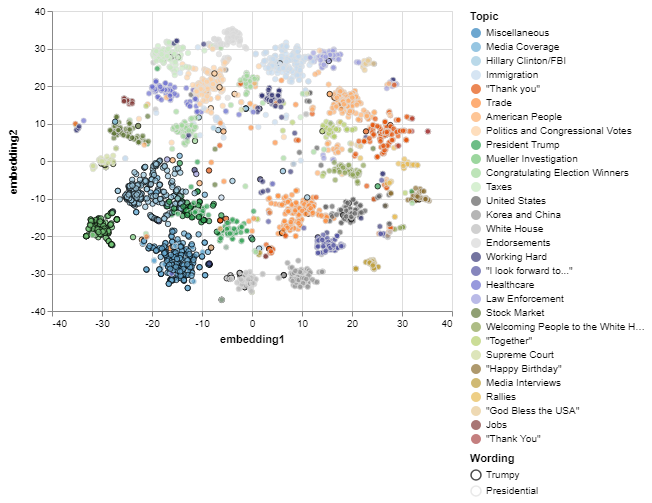

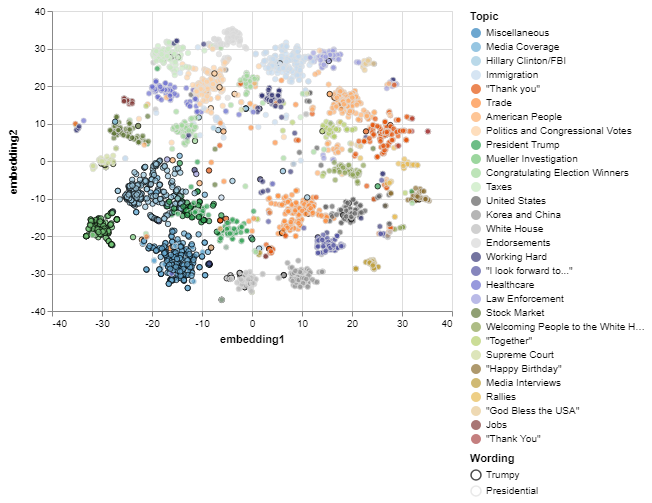

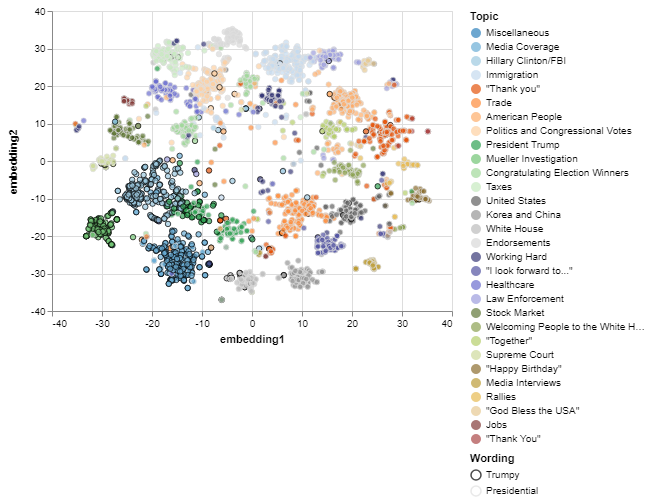

In [49]:
alt.Chart(trump_tweets.loc[trump_tweets.Topic != 'Miscellaneous']).mark_circle(strokeWidth=1).encode(
    x = 'embedding1',
    y = 'embedding2',
    fill = alt.Color('Topic', scale=topic_scale),
    stroke = alt.Color('Wording', legend = alt.Legend(title = 'Wording'), 
                       scale = alt.Scale(
                           domain = ['Trumpy', 'Presidential'], 
                           range = ['black','#e0e0e0']))
)

So after including the bigrams information, the Trumpy tweets (which have a black outline) still cluster in the same area of the t-SNE embedding, and they are better-separated than when we used unigrams. This indicates that our unigrams clustering did reflect the underlying data pretty well, but the unigrams data wasn't detailed enough to be able to tell that the Trumpy cluster was separate from the Presidential one (this remains true even if you try running t-SNE on the unigrams data, though I haven't shown that). 

# A Few Final Plots

The last plot showed that the Trumpy tweets are split among several topics. How do the topics break down with respect to Trumpiness?

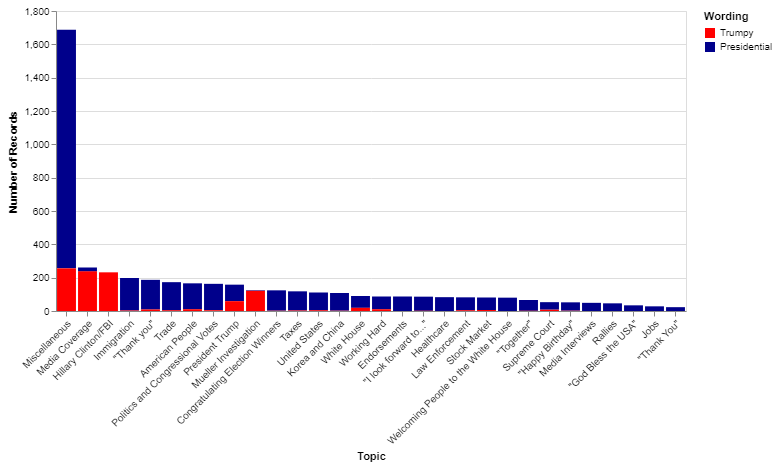

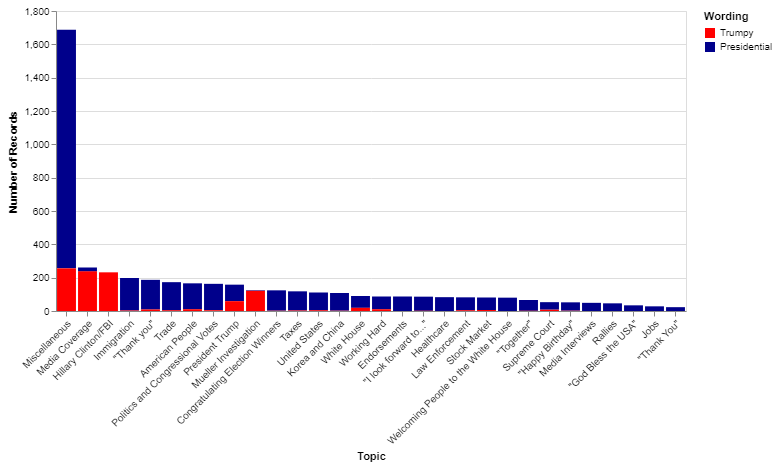

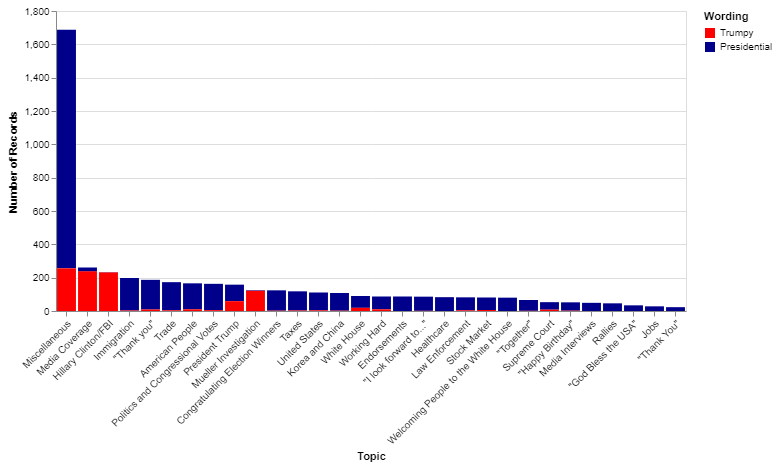

In [50]:
alt.Chart(trump_tweets).mark_bar().configure_axisX(
    labelAngle = -45
).encode(
    x = alt.X('Topic', sort = alt.EncodingSortField(field = 'Topic', op = 'count', order = 'descending')),
    y = alt.Y('count()'),
    color = alt.Color(field='Wording', type='nominal',
                      scale = alt.Scale(domain = ['Trumpy', 'Presidential'], range = ['red', 'darkBlue'])
                     )
)

These break down as one might expect: when President Trump talks about Hillary Clinton, media coverage, and the Mueller investigation, he uses Trumpy language; meanwhile, when @RealDonaldTrump tweets about policies, endorsements, and visits from foreign leaders, the language used is much more presidential. The histogram below is the same as above, except without the miscellaneous cluster:

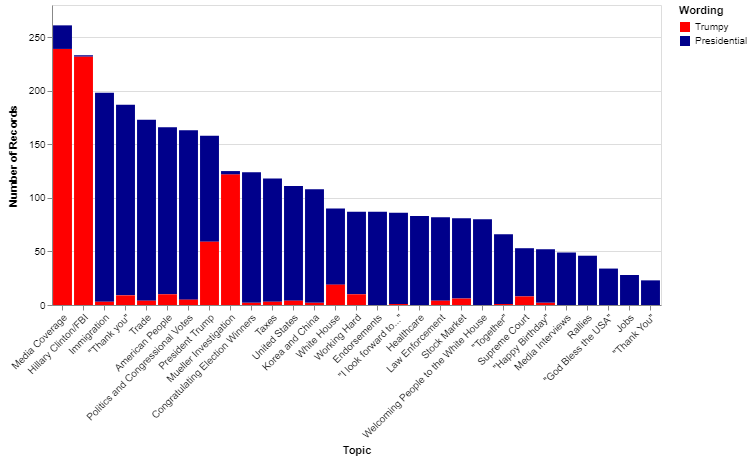

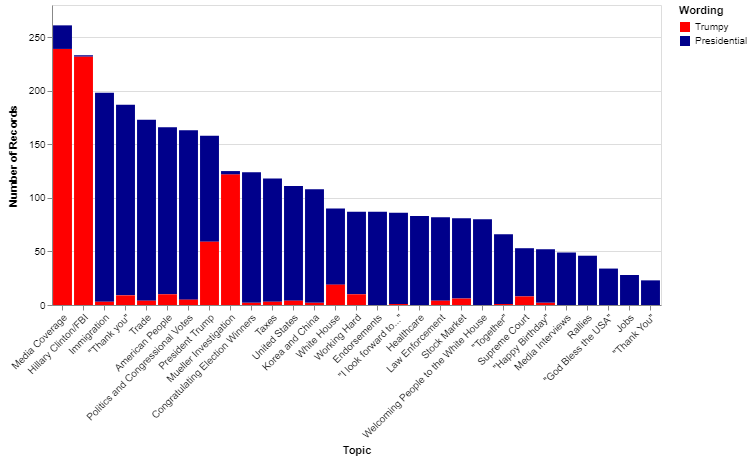

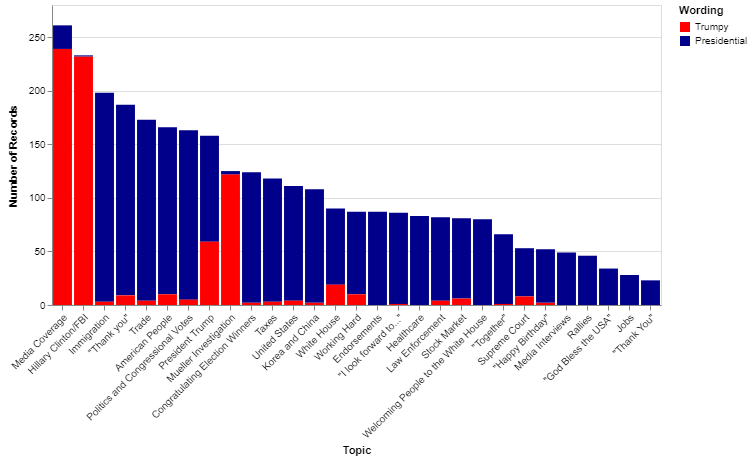

In [51]:
alt.Chart(trump_tweets.loc[trump_tweets.Topic != 'Miscellaneous']).mark_bar().configure_axisX(
    labelAngle = -45
).encode(
    x = alt.X('Topic', sort = alt.EncodingSortField(field = 'Topic', op = 'count', order = 'descending')),
    y = alt.Y('count()'),
    color = alt.Color(field='Wording', type='nominal', 
                      scale = alt.Scale(domain = ['Trumpy', 'Presidential'], range = ['red', 'darkBlue']))
)

It is also interesting to see the times of day at which these tweets come. As expected, the Trumpiest tweets&mdash;those about the media ("Fake News!"), Hillary Clinton and the FBI ("Crooked Hillary...") and the special counsel investigation ("Witch Hunt!") are usually sent in the morning:

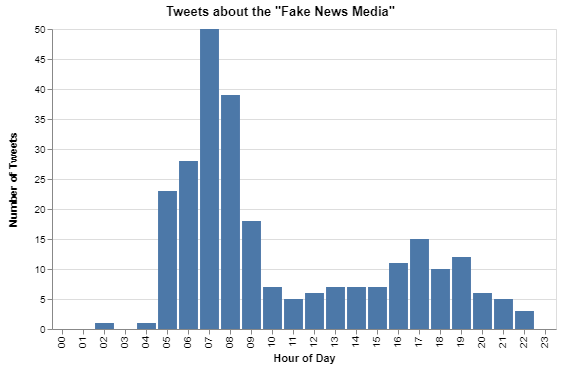

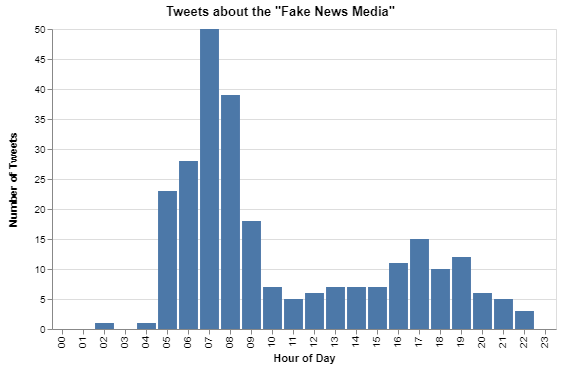

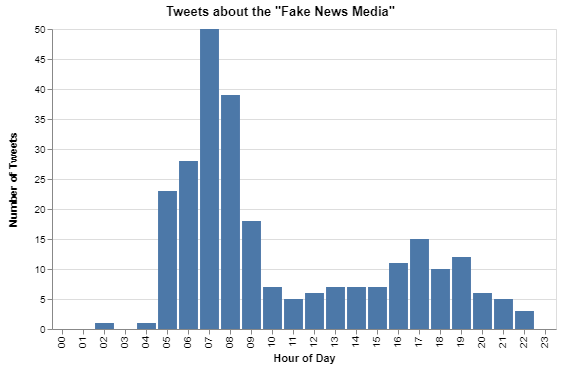

In [52]:
alt.Chart(trump_tweets.loc[(trump_tweets.Topic == 'Media Coverage')]).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day'), scale = alt.Scale(domain = list(range(24)))),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets'))
).properties(title = 'Tweets about the "Fake News Media"')

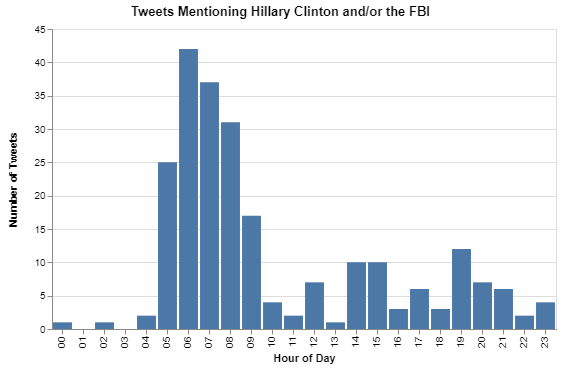

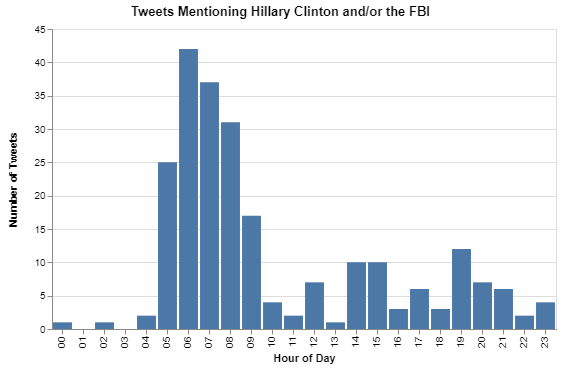

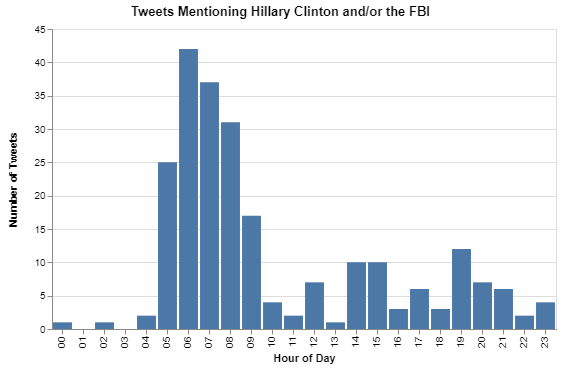

In [53]:
alt.Chart(trump_tweets.loc[(trump_tweets.Topic == 'Hillary Clinton/FBI')]).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day'), scale = alt.Scale(domain = list(range(24)))),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
).properties(title = 'Tweets Mentioning Hillary Clinton and/or the FBI')

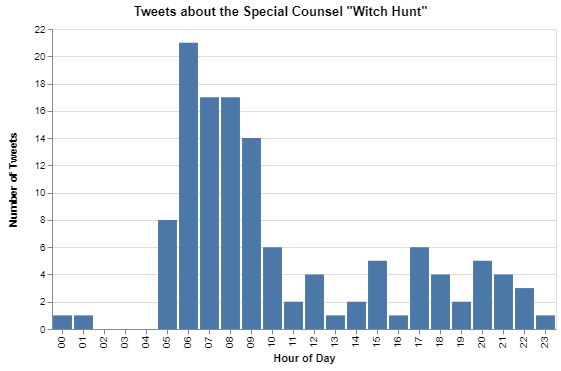

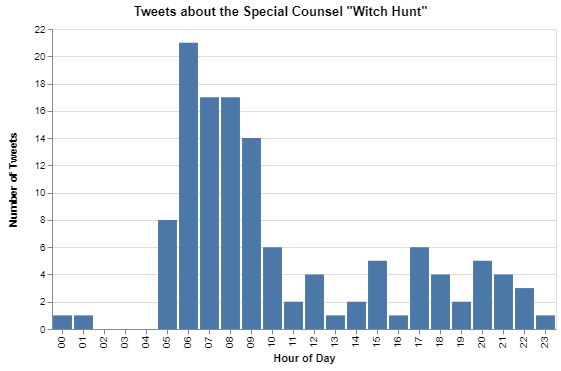

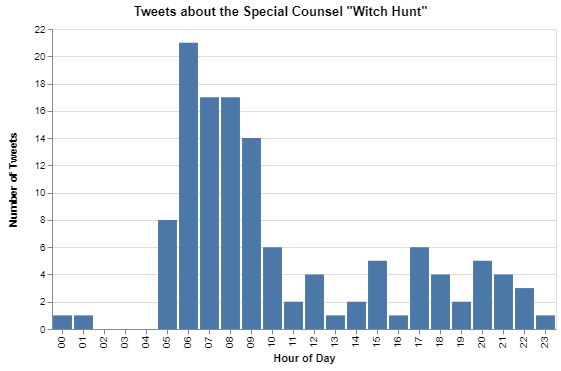

In [54]:
alt.Chart(trump_tweets.loc[(trump_tweets.Topic == 'Mueller Investigation')]).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day'), scale = alt.Scale(domain = list(range(24)))),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
).properties(title = 'Tweets about the Special Counsel "Witch Hunt"')

Other topics are tweeted about at other times. For example, tweets about welcoming people to the White House are usually sent in the afternoon:

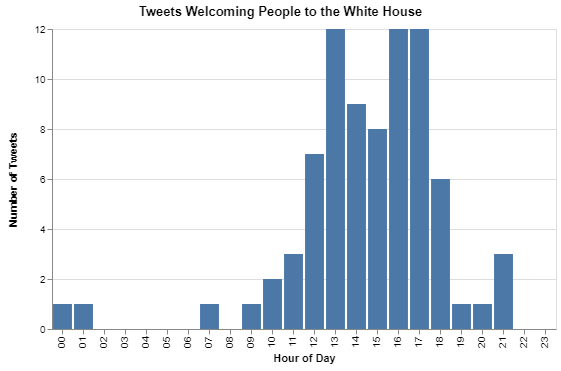

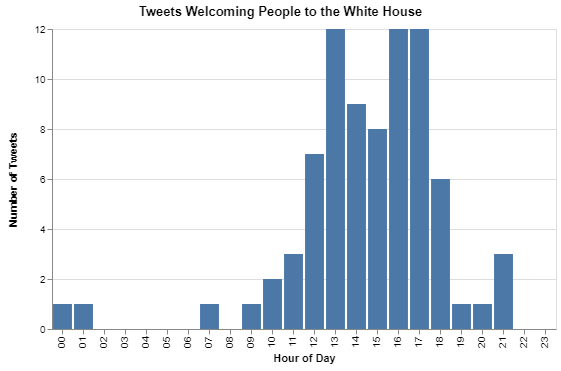

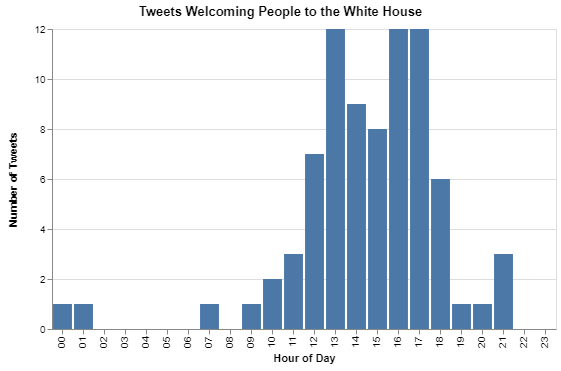

In [55]:
alt.Chart(trump_tweets.loc[(trump_tweets.Topic == 'Welcoming People to the White House')]).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day'), scale = alt.Scale(domain = list(range(24)))),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
).properties(title = 'Tweets Welcoming People to the White House')

Meanwhile, endorsements are tweeted throughout the day:

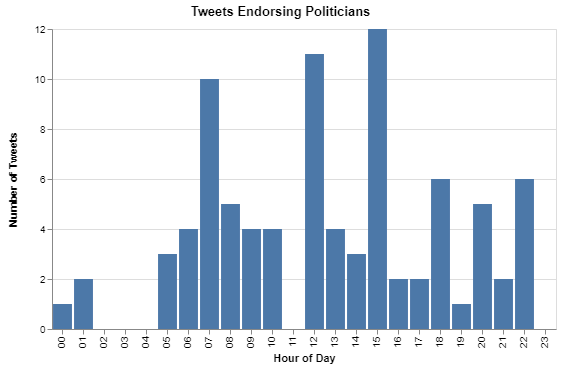

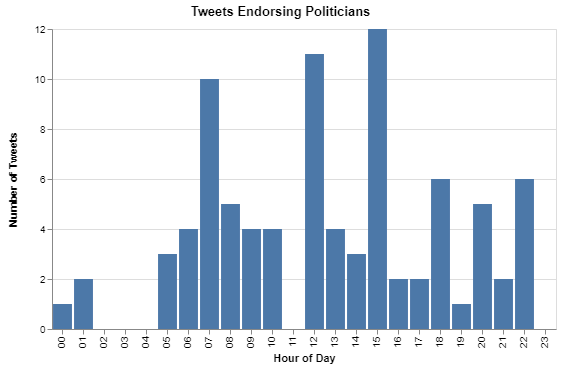

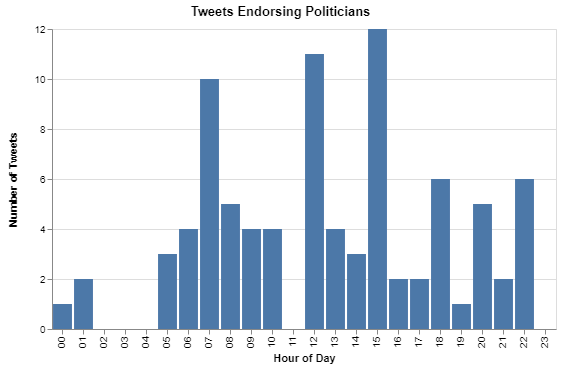

In [56]:
alt.Chart(trump_tweets.loc[(trump_tweets.Topic == 'Endorsements')]).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day'), scale = alt.Scale(domain = list(range(24)))),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
).properties(title = 'Tweets Endorsing Politicians')

Finally, tweets about President Trump's rallies usually come during normal working hours or in the evening:

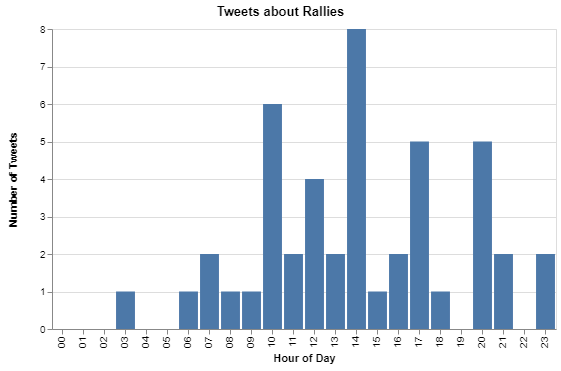

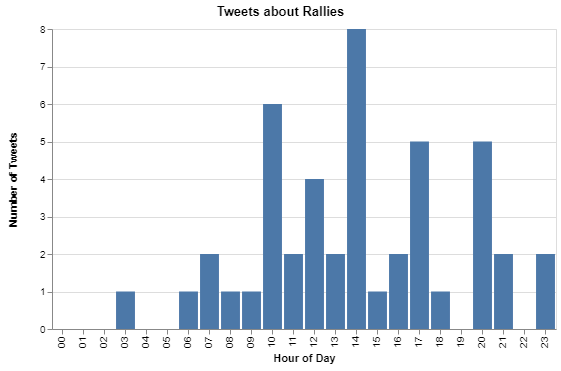

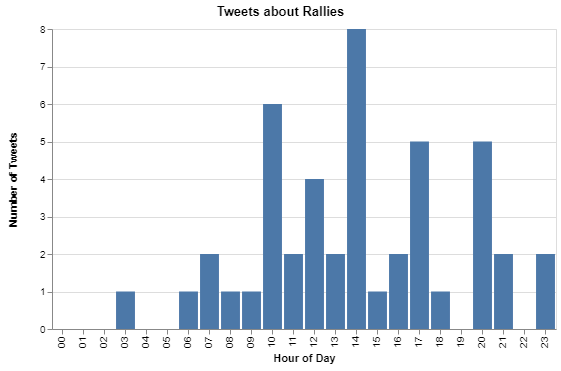

In [57]:
alt.Chart(trump_tweets.loc[(trump_tweets.Topic == 'Rallies')]).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day'), scale = alt.Scale(domain = list(range(24)))),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
).properties(title = 'Tweets about Rallies')

These plots, when taken together, are futher evidence in favor of the idea that Donald Trump himself often tweets early in the morning, while staffers tweet from his account about official Presidential matters later in the day.